In [1]:
# Essentials
import numpy as np
import matplotlib.pyplot as plt
import random
from tqdm import tqdm
from collections import Counter
# Librosa
import librosa
import librosa.display
# Distance
from scipy.spatial.distance import euclidean
from sklearn.metrics.pairwise import cosine_similarity
# Fourier Transforms
from scipy.fft import fft, fftfreq, fftshift
# Unsupervised Learning
from sklearn.cluster import KMeans
from scipy.cluster.hierarchy import linkage
from scipy.cluster.hierarchy import dendrogram
from sklearn.cluster import AgglomerativeClustering
from hmmlearn import hmm
# Imported Modules
from hmmlearn import *
from mfcc_features import *
from summarization import *
from kmeans_hmm import *

# Loading the Music Samples

In [2]:
def open_audio_sample(path):
    """Loads the audio sample"""
    audio, sr = librosa.load(path)
    return audio, sr

def show_signal(audio, sr, title):
    """Plots the audio signal"""
    plt.figure(figsize=(14, 5))
    librosa.display.waveplot(audio, sr)
    plt.ylabel('Amplitude')
    plt.title(title)
    plt.show()

### Spring by Vivaldi

In [3]:
path_spring = 'Spring.wav'
spring, sr = open_audio_sample(path_spring)

In [4]:
duration_spring = librosa.core.get_duration(spring, sr)
print('Duration Spring: '+ str(duration_spring))

Duration Spring: 215.2968707482993


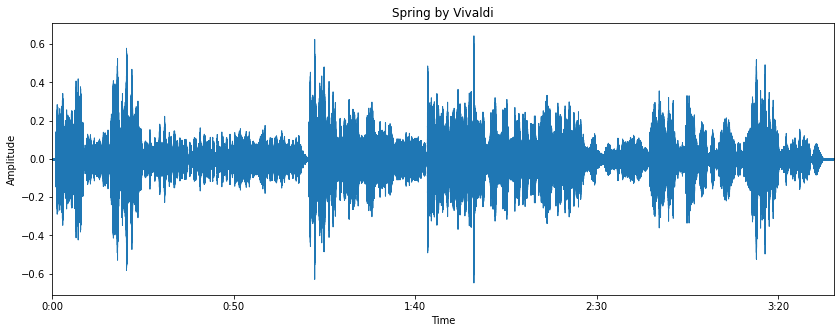

In [5]:
show_signal(spring, sr, 'Spring by Vivaldi')

### The Magical Mystery Tour by the Beatles

In [6]:
path_beatles = 'beatles.wav'
beatles, sr = open_audio_sample(path_beatles)

In [7]:
duration_beatles = librosa.core.get_duration(beatles, sr)
print('Duration Beatles: '+ str(duration_beatles))

Duration Beatles: 170.1370068027211


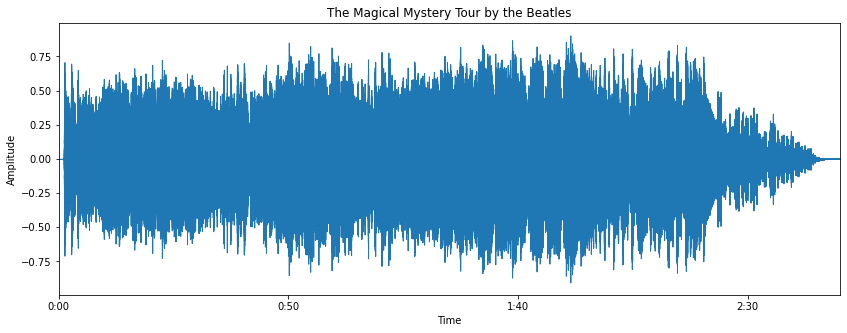

In [8]:
show_signal(beatles, sr, 'The Magical Mystery Tour by the Beatles')

# Cooper's approach: Similarity Matrices

## MFCC features computed by hand

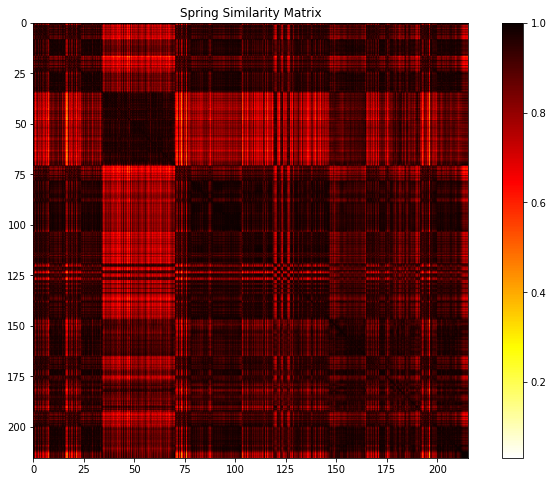

In [9]:
title = 'Spring Similarity Matrix'
sim_spring = SimilarityMatrix(spring, sr, title)
sim_spring.plotting_the_similarity_matrix()

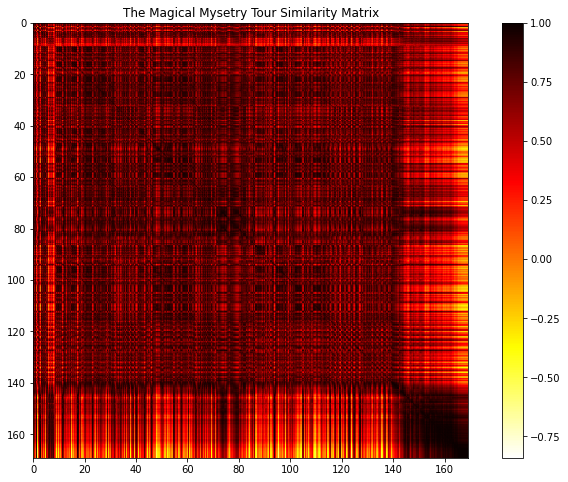

In [10]:
title = 'The Magical Mysetry Tour Similarity Matrix'
sim_magic = SimilarityMatrix(beatles, sr, title)
sim_magic.plotting_the_similarity_matrix()

## Comparison with the MFCCs

In [11]:
def plot_both_sims(feat_hand, feat_librosa, time):
    
    sim_hand = cosine_similarity(feat_hand.T)
    sim_librosa = cosine_similarity(feat_librosa.T)
  
    plt.figure(figsize=(14, 10))
    
    plt.subplot(1, 2, 1)
    plt.imshow(sim_hand, extent=[0,time,time,0])
    plt.title('Similarity Computed by Hand')
    plt.xlabel('Time')
    plt.ylabel('Time')
    plt.set_cmap('hot_r')
    plt.colorbar(shrink=0.5)    
    

    plt.subplot(1, 2, 2)
    plt.imshow(sim_librosa, extent=[0,time,time,0])
    plt.title('Similarity Computed by the Librosa Library')
    plt.xlabel('Time')
    plt.ylabel('Time')
    plt.set_cmap('hot_r')
    plt.colorbar(shrink=0.5)

    plt.show()

### Spring by Vivaldi

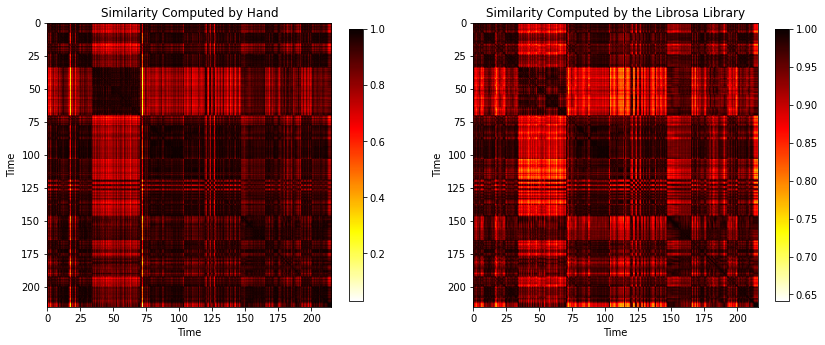

In [12]:
feat_spring_lib = librosa.feature.mfcc(y = spring, n_mfcc=13)
plot_both_sims(sim_spring.feat, feat_spring_lib, sim_spring.time)

### The Magical Mystery Tour by The Beatles

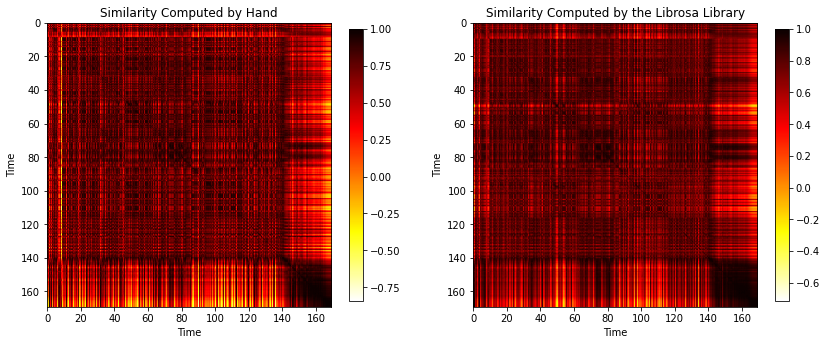

In [13]:
feat_magic_lib = librosa.feature.mfcc(y = beatles, n_mfcc=13)
plot_both_sims(sim_magic.feat, feat_magic_lib, sim_magic.time)

## Music Summarization

## Spring

### Features implemented by hand

Start10: 185.89306956724175
Start20: 71.02663251345041
Start30: 11.634873220011013


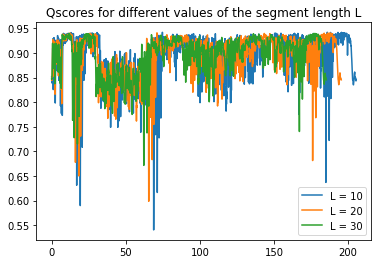

In [14]:
List_scores_to_plot = []
for L in [10, 20, 30]:
    music_sum = MusicSummarization(sim_spring.similarity, L, sim_spring.time)
    q = music_sum.get_best_score()
    print(f'Start{L}: {q}')
    List_scores_to_plot.append(music_sum.comb)

music_sum.plotting_Qscore(List_scores_to_plot)

### Features implemented with Librosa

Start10: 26.842421774583297
Start20: 25.478093708732953
Start30: 8.661355568412173


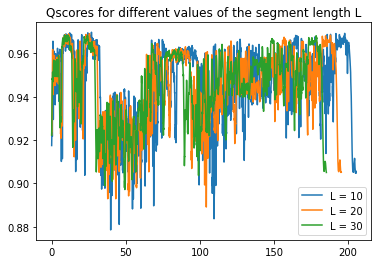

In [35]:
List_scores_to_plot = []
sim_lib_spring = cosine_similarity(feat_spring_lib.T)
for L in [10, 20, 30]:
    music_sum = MusicSummarization(sim_lib_spring, L, duration_spring)
    q = music_sum.get_best_score()
    print(f'Start{L}: {q}')
    List_scores_to_plot.append(music_sum.comb)

music_sum.plotting_Qscore(List_scores_to_plot)

## The Magical Mystery Tour

### Features implemented by hand

Start10: 19.173882248571527
Start20: 26.26938460773034
Start30: 103.24158273803477


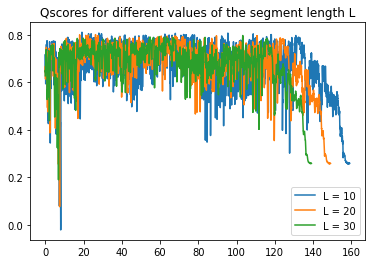

In [16]:
List_scores_to_plot = []
for L in [10, 20, 30]:
    music_sum = MusicSummarization(sim_magic.similarity, L, sim_magic.time)
    q = music_sum.get_best_score()
    print(f'Start{L}: {q}')
    List_scores_to_plot.append(music_sum.comb)

music_sum.plotting_Qscore(List_scores_to_plot)

### Features implemented with Librosa

Start10: 20.178532222510434
Start20: 125.131294844474
Start30: 116.7264255648813


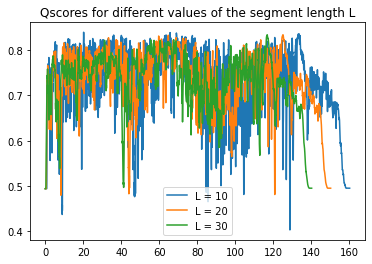

In [33]:
List_scores_to_plot = []
sim_lib_magic = cosine_similarity(feat_magic_lib.T)
for L in [10, 20, 30]:
    music_sum = MusicSummarization(sim_lib_magic, L, duration_beatles)
    q = music_sum.get_best_score()
    print(f'Start{L}: {q}')
    List_scores_to_plot.append(music_sum.comb)

music_sum.plotting_Qscore(List_scores_to_plot)

## Adding the Delta and Delta Deltas to the features

In [22]:
def plot_similarity_matrix(feat, title, time):
    sim = cosine_similarity(feat.T)
    plt.imshow(sim, extent=[0,time,time,0])
    plt.title(title)
    plt.set_cmap('hot_r')
    plt.colorbar()
    plt.show()

## Spring

In [20]:
mfcc = librosa.feature.mfcc(y=spring, sr=sr, n_mfcc=13)
mfcc_delta = librosa.feature.delta(mfcc)
mfcc_delta_delta = librosa.feature.delta(mfcc, order=2)
feat_spring = np.concatenate((mfcc, mfcc_delta, mfcc_delta_delta), axis = 0)

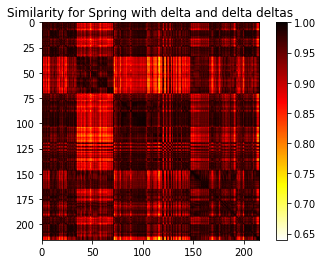

In [24]:
title = 'Similarity for Spring with delta and delta deltas'
plot_similarity_matrix(feat_spring, title, duration_spring)

Start10: 26.842421774583297
Start20: 11.440867266059039
Start30: 8.661355568412173


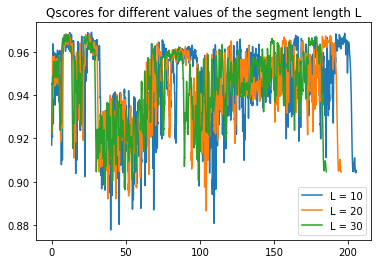

In [25]:
List_scores_to_plot = []
sim_lib_spring = cosine_similarity(feat_spring.T)
for L in [10, 20, 30]:
    music_sum = MusicSummarization(sim_lib_spring, L, duration_spring)
    q = music_sum.get_best_score()
    print(f'Start{L}: {q}')
    List_scores_to_plot.append(music_sum.comb)

music_sum.plotting_Qscore(List_scores_to_plot)

## The Magical Mystery Tour

In [30]:
mfcc = librosa.feature.mfcc(y=beatles, sr=sr, n_mfcc=13)
mfcc_delta = librosa.feature.delta(mfcc)
mfcc_delta_delta = librosa.feature.delta(mfcc, order=2)
feat_beatles = np.concatenate((mfcc, mfcc_delta, mfcc_delta_delta), axis = 0)

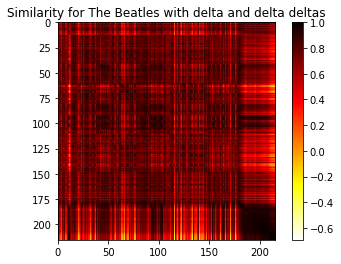

In [31]:
title = 'Similarity for The Beatles with delta and delta deltas'
plot_similarity_matrix(feat_beatles, title, duration_spring)

Start10: 20.178532222510434
Start20: 125.131294844474
Start30: 116.7264255648813


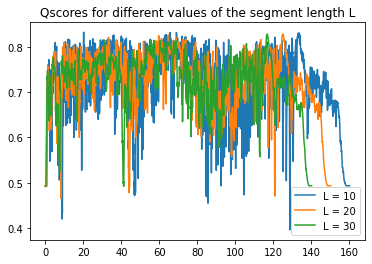

In [32]:
List_scores_to_plot = []
sim_lib_beatles = cosine_similarity(feat_beatles.T)
for L in [10, 20, 30]:
    music_sum = MusicSummarization(sim_lib_beatles, L, duration_beatles)
    q = music_sum.get_best_score()
    print(f'Start{L}: {q}')
    List_scores_to_plot.append(music_sum.comb)

music_sum.plotting_Qscore(List_scores_to_plot)

# Rodet's Approach: KMeans and HMM Model

In [6]:
spring_feat = feat_matrix_librosa(spring, sr)

In [7]:
pot_states, states = computing_initial_states(spring_feat, hop_length=4096, sr=sr)

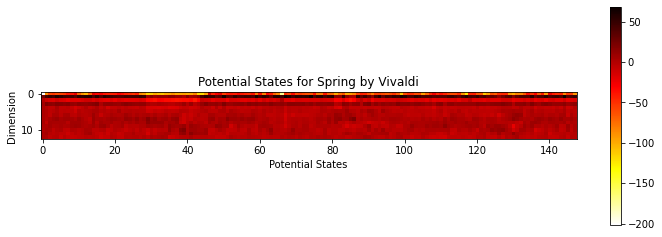

In [8]:
title = 'Potential States for Spring by Vivaldi'
xlabel = 'Potential States'
ylabel = 'Dimension'
plotting_figures(pot_states.T, title, xlabel, ylabel)

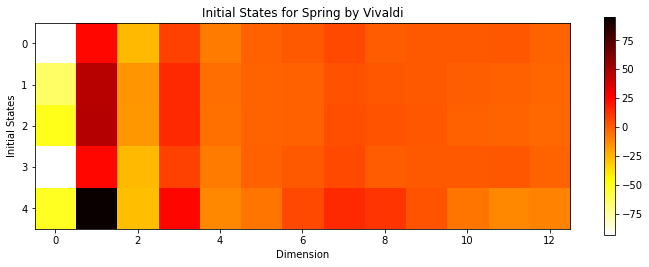

In [9]:
title = 'Initial States for Spring by Vivaldi'
xlabel = 'Dimension'
ylabel = 'Initial States'
plotting_figures(states, title, xlabel, ylabel)

## KMeans

In [10]:
startpts=states
num_classes = states.shape[0]

kmeans = KMeans(n_clusters=num_classes, init=startpts, n_init=1)

kmeans.fit(spring_feat.T)

mid_states=kmeans.cluster_centers_
predictions = kmeans.predict(spring_feat.T)

changes = sudden_changes(predictions)
new_labels = smooth_function(changes, L=10)
print(f'Distribution of the clusters in the smoothed version: {Counter(new_labels)}')

Distribution of the clusters in the smoothed version: Counter({2: 377, 1: 344, 4: 234, 3: 167, 0: 38})


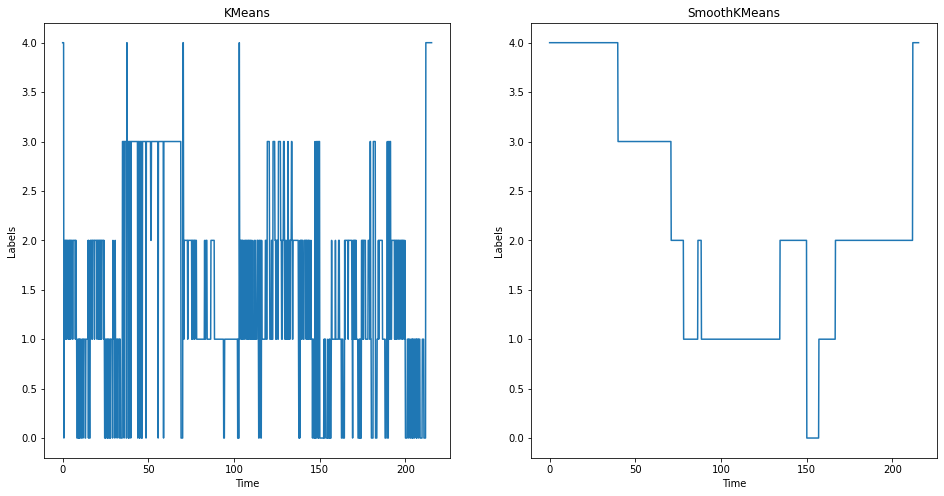

In [11]:
title = 'KMeans'
xlabel = 'Time'
ylabel = 'Labels'
time = duration_spring
plot_states_booth(predictions, new_labels, time, title, xlabel, ylabel)

## Hierarchical Clustering

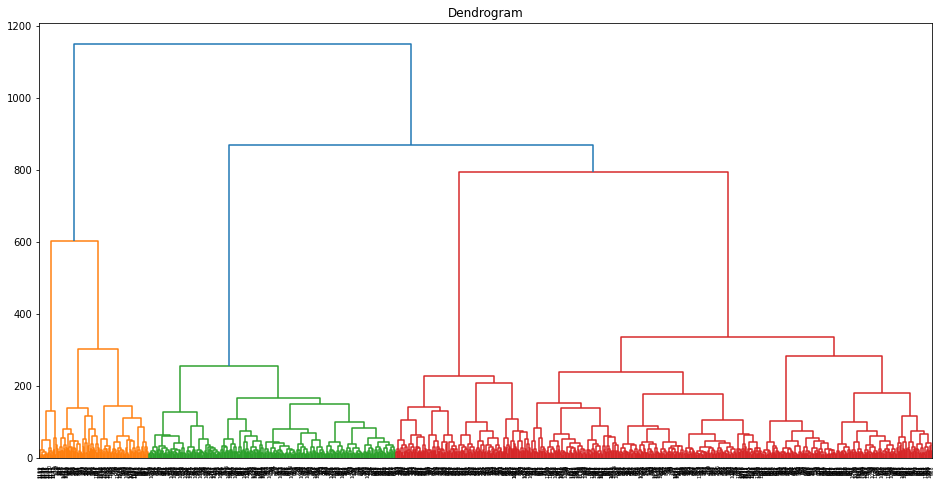

Distribution of the clusters in the smoothed version: Counter({0: 508, 2: 394, 3: 160, 4: 84, 1: 14})


In [12]:
Z_0 = linkage(spring_feat.T, 'ward')
fig = plt.figure(figsize=(16, 8))
dn = dendrogram(Z_0)
plt.title('Dendrogram')
plt.show()


agg_clust = AgglomerativeClustering(n_clusters=num_classes, linkage = "ward").fit(spring_feat.T)
predictions = agg_clust.labels_

changes = sudden_changes(predictions)
new_labels = smooth_function(changes, 10)
print(f'Distribution of the clusters in the smoothed version: {Counter(new_labels)}')

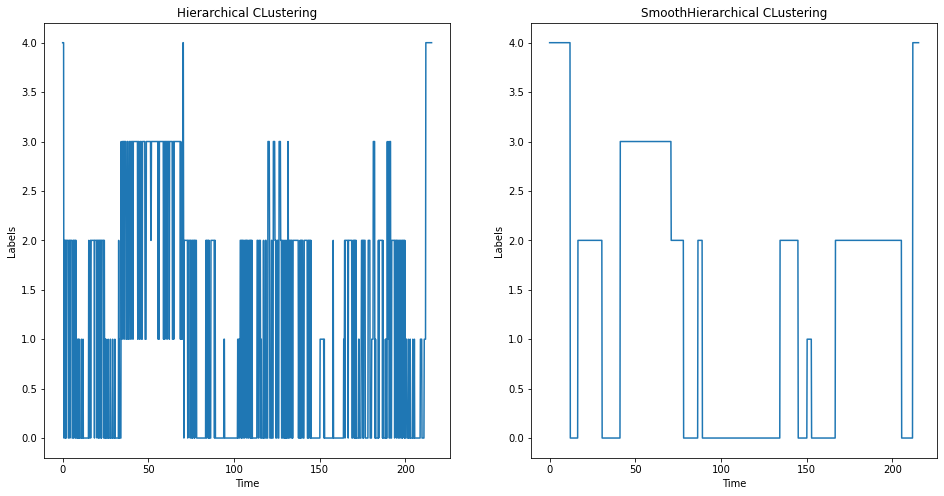

In [13]:
title = 'Hierarchical CLustering'
xlabel = 'Time'
ylabel = 'Labels'
time = duration_spring
plot_states_booth(predictions, new_labels, time, title, xlabel, ylabel)

## Hidden Markov Model

In [14]:
random.seed(42)

remodel = hmm.GaussianHMM(n_components=num_classes, covariance_type="full", n_iter=100)
remodel.means_prior = kmeans.cluster_centers_
remodel.fit(spring_feat.T)
predictions = remodel.predict(spring_feat.T)

changes = sudden_changes(predictions)
new_labels = smooth_function(changes, 20)

print(f'Distribution of the clusters in the smoothed version: {Counter(predictions)}')

Distribution of the clusters in the smoothed version: Counter({2: 450, 0: 252, 3: 245, 1: 186, 4: 27})


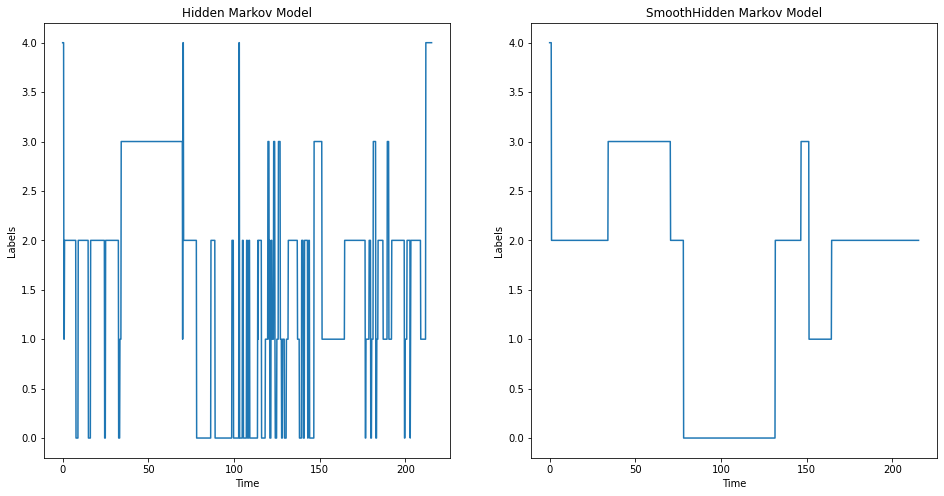

In [15]:
title = 'Hidden Markov Model'
xlabel = 'Time'
ylabel = 'Labels'
time = duration_spring
plot_states_booth(predictions, new_labels, time, title, xlabel, ylabel)

In [20]:
def wasserstein_dist(mu_0, K_0, mu_1, K_1):

    sqrtK_0 = scipy.linalg.sqrtm(K_0)
    first_term = np.dot(sqrtK_0, K_1)
    K_0_K_1_K_0 = np.dot(first_term, sqrtK_0)

    cov_dist = np.trace(K_0) + np.trace(K_1) - 2 * np.trace(scipy.linalg.sqrtm(K_0_K_1_K_0))
    l2norm = (np.sum(np.square(abs(mu_0 - mu_1))))
    d = np.real(np.sqrt(l2norm + cov_dist))

    return d

def similarity(m, sig):
    n, p = m.shape
    sim = np.zeros((n ,n))
    for i in range(n):
        for j in range(n):
            if i == j:
                sim[i,j] = 0
            else:
                sim[i, j] = wasserstein_dist(m[i], sig[i], m[j], sig[j])
    return sim

In [21]:
m = remodel.means_
sig = remodel.covars_

s = similarity(m, sig)

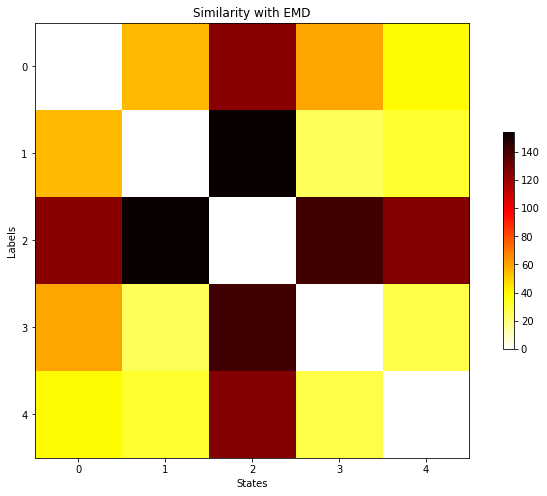

In [22]:
title = 'Similarity with EMD'
xlabel = 'States'
y_lable = 'States'
plotting_figures(s, title, xlabel, ylabel)